3. Which player has the highest number of wins?

Loading Data:

In [1]:
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns


folder_path = Path('../data/input/raw_match_parquet')

# Events Data
events_dfs = []

for parquet_file in folder_path.glob('event_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id','winner_code'])
        events_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if events_dfs:
    events_data = pd.concat(events_dfs, ignore_index=True)
    print("\n--- Combined Event DataFrame Info ---")
    print(events_data.shape)
    print(events_data.head())
    print(f"Successfully combined {len(events_dfs)} event parquet files.")
else:
    print(f"No 'event_*.parquet' files found in {folder_path} or no files could be read.")



#Away Team
all_away_team_dfs = []

for parquet_file in folder_path.glob('away_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'full_name', 'gender'])
        all_away_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_away_team_dfs:
    away_team_data = pd.concat(all_away_team_dfs, ignore_index=True)
    print("\n--- Combined Away Team DataFrame Info ---")
    print(away_team_data.shape)
    print(away_team_data.head())
    print(f"Successfully combined {len(all_away_team_dfs)} away team parquet files.")
else:
    print(f"No 'away_team_*.parquet' files found in {folder_path} or no files could be read.")

# Home Team
all_home_team_dfs = []

for parquet_file in folder_path.glob('home_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=['match_id', 'full_name', 'gender'])
        all_home_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_home_team_dfs:
    home_team_data = pd.concat(all_home_team_dfs, ignore_index=True)
    print("\n--- Combined Home Team DataFrame Info ---")
    print(home_team_data.shape)
    print(home_team_data.head())
    print(f"Successfully combined {len(all_home_team_dfs)} home team parquet files.")
else:
    print(f"No 'home_team_*.parquet' files found in {folder_path} or no files could be read.")


Successfully read event_11974049.parquet
Successfully read event_11974052.parquet
Successfully read event_11974053.parquet
Successfully read event_11974065.parquet
Successfully read event_11974066.parquet
Successfully read event_11974067.parquet
Successfully read event_11974068.parquet
Successfully read event_11974070.parquet
Successfully read event_11974071.parquet
Successfully read event_11974072.parquet
Successfully read event_11974113.parquet
Successfully read event_11987997.parquet
Successfully read event_11998445.parquet
Successfully read event_11998446.parquet
Successfully read event_11998447.parquet
Successfully read event_11998448.parquet
Successfully read event_11998449.parquet
Successfully read event_11998450.parquet
Successfully read event_11998451.parquet
Successfully read event_11998452.parquet
Successfully read event_11998453.parquet
Successfully read event_11998454.parquet
Successfully read event_11998455.parquet
Successfully read event_11998456.parquet
Successfully rea

Merging Data Frames and Handling NaNs:

In [ ]:
merged_df = pd.merge(events_data, away_team_data, on='match_id', how='left')
merged_df = pd.merge(merged_df, home_team_data, on='match_id', how='left', suffixes=('_away_team', '_home_team'))
columns_to_fill = ['full_name_away_team', 'full_name_home_team', 'gender_away_team', 'gender_home_team']
merged_df[columns_to_fill] = merged_df[columns_to_fill].fillna('Not Mentioned')

print(merged_df.head())
print(merged_df.info())


--- Merged DataFrame with 'Not Mentioned' ---
   match_id winner_code full_name_away_team gender_away_team  \
0  11974049           2       Not Mentioned    Not Mentioned   
1  11974052           2       Not Mentioned    Not Mentioned   
2  11974053           1       Not Mentioned    Not Mentioned   
3  11974065           1       Not Mentioned    Not Mentioned   
4  11974066           2       Not Mentioned    Not Mentioned   

  full_name_home_team gender_home_team  
0       Not Mentioned    Not Mentioned  
1       Not Mentioned    Not Mentioned  
2       Not Mentioned    Not Mentioned  
3       Not Mentioned    Not Mentioned  
4       Not Mentioned    Not Mentioned  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16873 entries, 0 to 16872
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   match_id             16873 non-null  int64 
 1   winner_code          14493 non-null  object
 2   full_name_awa

Finding the Winning Name and Gender:

In [21]:
def get_winning_info(row):
    winner_code = row['winner_code']
    
    if winner_code == 1:
        return row['full_name_home_team'], row['gender_home_team']
    elif winner_code == 2:
        return row['full_name_away_team'], row['gender_away_team']
    else:
        return 'Not Mentioned', 'Not Mentioned' 

merged_df[['winning_full_name', 'winner_gender']] = merged_df.apply(get_winning_info, axis=1, result_type='expand')

excluded_winners = ['Not Mentioned', None] 
actual_winner_counts = merged_df[~merged_df['winning_full_name'].isin(excluded_winners)]['winning_full_name'].value_counts()

print("\n--- Analysis of Actual Winners ---")
if not actual_winner_counts.empty:
    print(f"Total actual winners found: {len(actual_winner_counts)}")
    print("\nCounts of winner_code for each full_name:")
    print(actual_winner_counts)
    most_wins_full_name = actual_winner_counts.index[0]
    most_wins_count = actual_winner_counts.iloc[0]
    print(f"\nPlayer/Team with the most wins: '{most_wins_full_name}' with {most_wins_count} wins.")
else:
    print("\nNo team wins found.")


--- Analysis of Actual Winners ---
Total actual winners found: 2320

Counts of winner_code for each full_name:
winning_full_name
Popko, Dmitry                        29
Chidekh, Clement                     22
Gengel, Marek                        21
Jianu, Filip Cristian                21
Dellien Velasco, Murkel Alejandro    20
                                     ..
Ahn, Yu Jin                           1
Chepelev, Andrey                      1
Zielinski, Marcel                     1
Seggerman, Ryan                       1
Leon, Sabastiani                      1
Name: count, Length: 2320, dtype: int64

Player/Team with the most wins: 'Popko, Dmitry' with 29 wins.


Visualizing Full Name Wins:

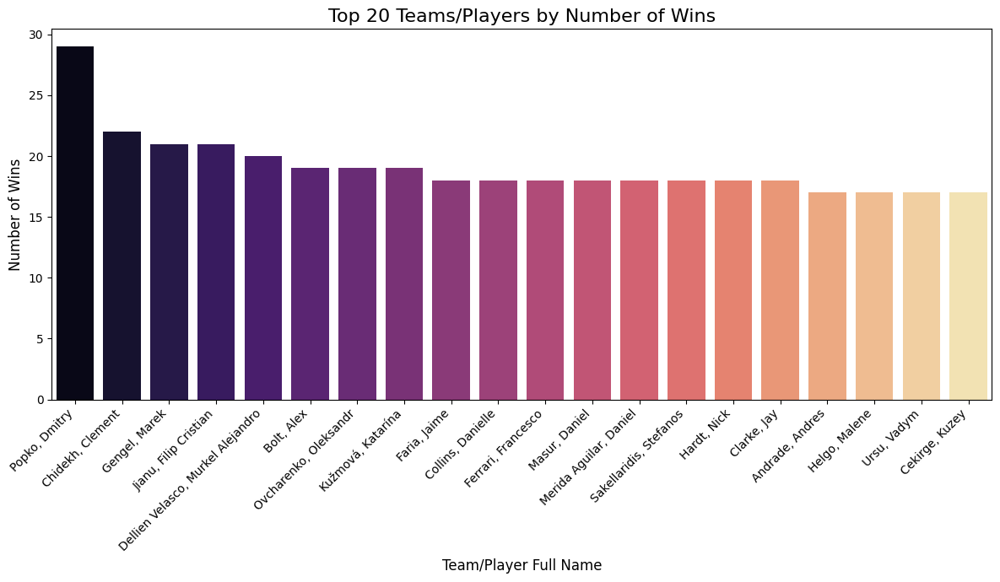

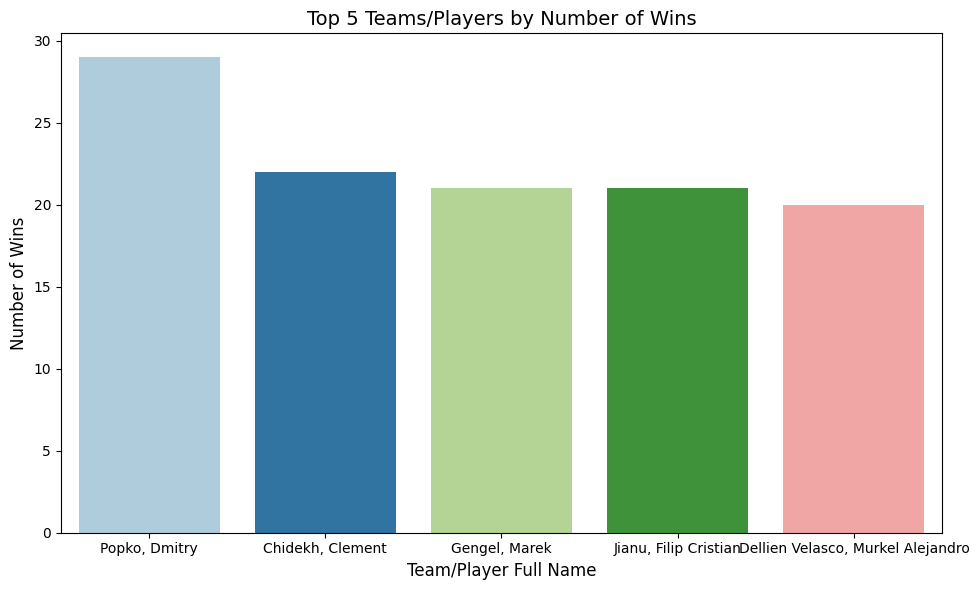

In [28]:
top_n = 20 
top_winners = actual_winner_counts.head(top_n)

if not top_winners.empty:
    plt.figure(figsize=(12, 7)) 
    
    sns.barplot(x=top_winners.index, y=top_winners.values, hue=top_winners.index, palette='magma', legend=False)
    
    plt.title(f'Top {len(top_winners)} Teams/Players by Number of Wins', fontsize=16)
    plt.xlabel('Team/Player Full Name', fontsize=12)
    plt.ylabel('Number of Wins', fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.tight_layout()

     # Saving the output as png.
    output_directory = Path('../data/output')
    file_name = "Top 20 wins.png" 
    full_path = output_directory / file_name
    plt.savefig(full_path, dpi=300)
    
    plt.show()

top_n_5 = 5
top_winners_5 = actual_winner_counts.head(top_n_5)
    
if len(top_winners_5) > 0:
    plt.figure(figsize=(10, 6))
    sns.barplot(x=top_winners_5.index, y=top_winners_5.values, hue=top_winners_5.index, palette='Paired', legend=False)
    plt.title(f'Top {len(top_winners_5)} Teams/Players by Number of Wins', fontsize=14)
    plt.xlabel('Team/Player Full Name', fontsize=12)
    plt.ylabel('Number of Wins', fontsize=12)
    plt.xticks(rotation=0)
    plt.tight_layout()
    
    # Saving the output as png.
    output_directory = Path('../data/output')
    file_name = "Top 5 Wins.png" 
    full_path = output_directory / file_name
    plt.savefig(full_path, dpi=300)

    plt.show()

Visualizing by Gender:

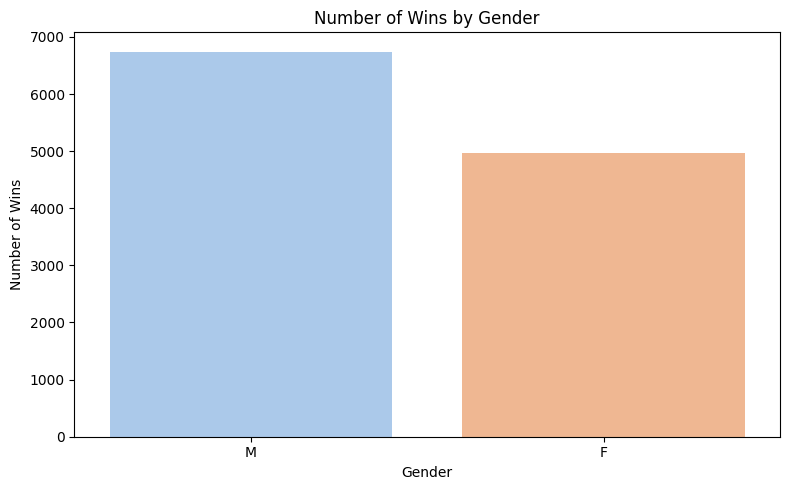

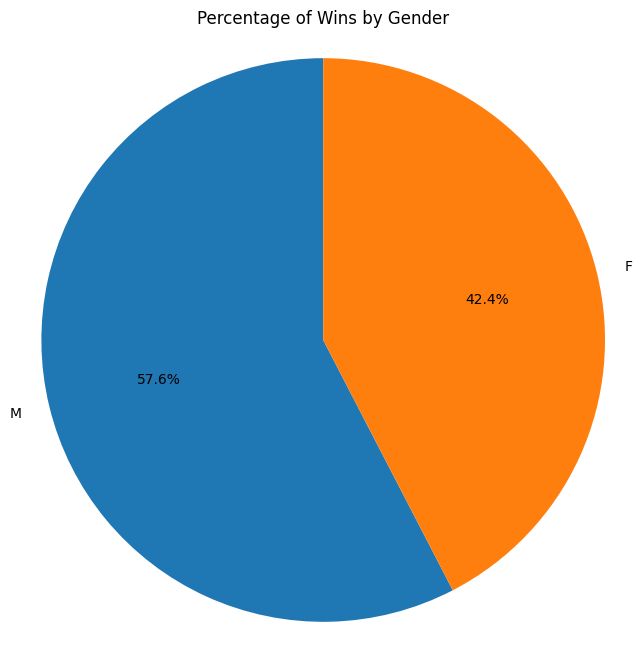

In [30]:
filtered_gender_df = merged_df[~merged_df['winning_full_name'].isin(excluded_winners)].copy()
filtered_gender_df = filtered_gender_df[filtered_gender_df['winner_gender'] != 'Not Mentioned']

if not filtered_gender_df.empty:
    winner_gender_counts = filtered_gender_df['winner_gender'].value_counts()
    
    plt.figure(figsize=(8, 5))
    sns.barplot(x=winner_gender_counts.index, y=winner_gender_counts.values, hue=winner_gender_counts.index, palette='pastel', legend=False)
    plt.title('Number of Wins by Gender')
    plt.xlabel('Gender')
    plt.ylabel('Number of Wins')
    plt.tight_layout()

    # Saving the output as png.
    output_directory = Path('../data/output')
    file_name = "Winners by Gender.png" 
    full_path = output_directory / file_name
    plt.savefig(full_path, dpi=300)

    plt.show()
    
    plt.figure(figsize=(8, 8))
    plt.pie(winner_gender_counts, labels=winner_gender_counts.index, autopct='%1.1f%%', startangle=90, colors=sns.color_palette('tab10'))
    plt.title('Percentage of Wins by Gender')
    plt.axis('equal') 

    # Saving the output as png.
    output_directory = Path('../data/output')
    file_name = "Winners by Gender Pie.png" 
    full_path = output_directory / file_name
    plt.savefig(full_path, dpi=300)

    plt.show()
else:
    print("\nNo gender data to plot.")